## Import

In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0"
# "4,5,6,7"
# "0,1,2,3"
num_gpus = len(os.environ["CUDA_VISIBLE_DEVICES"].split(","))
print("num_gpus:", num_gpus)
print("CUDA_VISIBLE_DEVICES:", os.environ["CUDA_VISIBLE_DEVICES"])

num_gpus: 1
CUDA_VISIBLE_DEVICES: 0


In [2]:
import re
import sys
import json
import random
import numpy as np
import pandas as pd
from tqdm import tqdm
import matplotlib.pyplot as plt

In [3]:
import torch
import transformers
from transformers import AutoTokenizer, AutoModel
from vllm import LLM, SamplingParams

In [4]:
from dataset.process import format_chat, format_chat_general, format_chat_mellama, format_chat_meditron

In [5]:
def seed_everything(seed):
    seed = int(seed)
    random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    transformers.set_seed(seed)
    print(f"seed everything: {seed}")

seed = 42
seed_everything(seed=seed)

seed everything: 42


## Task

In [8]:
task_name = "6.Brateca.hospitalization"
# "12.C-EMRS"
# "101.IFMIR.IncidentType"

In [9]:
# loading to ../data/processed/ into json file
path_file_data = f"dataset_raw/{task_name}.SFT.json"
print(f"Loading {path_file_data} ...")
with open(path_file_data, "r") as file:
    list_dict_data = json.load(file)
list_dict_data = [
    dict_data for dict_data in list_dict_data if dict_data["split"] == "test"
]
print(f"The number of data: {len(list_dict_data)}")

Loading dataset_raw/6.Brateca.hospitalization.SFT.json ...
The number of data: 3183


In [10]:
list_dict_data[0]

{'task': '6.Brateca.hospitalization',
 'language': 'pt',
 'type': 'clf',
 'id': 28643,
 'split': 'test',
 'instruction': 'Given a patient\'s basic information and clinical notes in Portuguese, predict whether the patient will require more than seven days of hospitalization.\nReturn your answer in the following format. DO NOT GIVE ANY EXPLANATION:\nHospitalization > 7 days: label\nThe optional list for "label" is ["Yes", "No"].',
 'input': 'Age: 72\nSkin Color: Branca\nSex: Male\nExam records:\nTime: 2029-10-02 12:04:29. Exam: Basófilos-15.0 /µL\nTime: 2029-10-02 13:35:27. Exam: Bilirrubina Total-0.4 mg/dL\nTime: 2029-10-02 14:05:52. Exam: Cálcio Iônico-5.33 mg/dL\nTime: 2029-10-02 12:04:29. Exam: C.H.C.M.-32.9 g/dL\nTime: 2029-10-02 13:35:28. Exam: Creatinina-0.89 mg/dL\nTime: 2029-10-02 12:04:29. Exam: Eosinófilos-94.0 /µL\nTime: 2029-10-02 12:04:29. Exam: Eritócitos-4.89 milhões/µL\nTime: 2029-10-02 12:04:29. Exam: Eritrócitos-4.89 milhões/µL\nTime: 2029-10-02 13:35:28. Exam: Ferro-7

## Tokenizer

In [11]:
# name of model
with open("/PHShome/jn180/llm_public_host/0-README/dict_model_path.json", "r") as f:
    dict_model_path = json.load(f)

In [12]:
model_name = 'MeLLaMA-13B-chat'
# 'BioMistral-7B'
# "meditron-7b"
# 'MeLLaMA-13B-chat'
path_dir_model = dict_model_path[model_name]
path_dir_model

'/netapp3/raw_data3/share/llm_public_host/MeLLaMA-13B-chat'

In [13]:
# # loading tokenizer
tokenizer = AutoTokenizer.from_pretrained(path_dir_model, padding_side='left')

## Task class

In [14]:
class EmptyArgs:
    def __init__(self):
        self.batch_size = 32
        self.gpus = os.environ["CUDA_VISIBLE_DEVICES"].split(",")
        self.model_path = path_dir_model
        self.model_name = model_name

args = EmptyArgs()

In [15]:
from model.init import load_config

load_config(args)
args.__dict__

{'batch_size': 32,
 'gpus': ['0'],
 'model_path': '/netapp3/raw_data3/share/llm_public_host/MeLLaMA-13B-chat',
 'model_name': 'MeLLaMA-13B-chat',
 'num_workers': 2,
 'max_token_all': 4096,
 'max_token_output': 512,
 'max_token_input': 3584}

In [ ]:
# from dataset.classification import Task_clf_IFMIR_IncidentType
# task = Task_clf_IFMIR_IncidentType(args=args, task=task_name)
# from dataset.classification import Task_clf_Dial_Med
# task = Task_clf_Dial_Med(args=args, task=task_name)

In [48]:
from dataset.classification import Task_clf_Brateca_hospitalization
task = Task_clf_Brateca_hospitalization(args=args, task=task_name)

Load 6.Brateca.hospitalization data: train: 25460, val: 3183, test: 3183


In [49]:
task.setup(tokenizer=tokenizer, prompt_mode='direct-5-shot')

Prompt mode: Direct
Prompt mode: Direct with 5-Shot
Load 5 examples for dataset_raw/example/6.Brateca.hospitalization.example.json


## Model - HF Pipeline

In [17]:
from transformers import pipeline

pipe = pipeline("text-generation", model=path_dir_model, device="cuda")

Loading checkpoint shards:   0%|          | 0/8 [00:00<?, ?it/s]

In [18]:
# Generate text
str_input = "The medical condition is characterized by"
generated_text = pipe(str_input, num_return_sequences=1)

/netapp2/home/jw1399/miniforge3/envs/vllm/lib/python3.10/site-packages/transformers/generation/utils.py:1220: UserWarning: Using the model-agnostic default `max_length` (=20) to control the generation length. We recommend setting `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(
Starting from v4.46, the `logits` model output will have the same type as the model (except at train time, where it will always be FP32)


In [19]:
print(generated_text)

[{'generated_text': 'The medical condition is characterized by the presence of a large number of small, round, bas'}]


In [20]:
print(generated_text[0]['generated_text'][len(str_input):])

 the presence of a large number of small, round, bas


In [21]:
str_input = """Given the medical incident report in Japanese, determine what type of incident occurred. One report might contain more than one incident type. The incident types and their definitions are as follows:
- "Wrong Drug": Wrong drug occurs when inappropriate medication or IV fluid is prescribed, dispensed, prepared or administered. Wrong drug applies when the intended drug and the actual drug are different. A generic substitution is not considered as a wrong drug.
- "Wrong Form": Wrong form occurs when the wrong form of drug is ordered, dispensed or administered.
- "Wrong Mode": Wrong mode occurs when the wrong mode of a medication is ordered, dispensed or administered.
- "Wrong Strength amount": Wrong amount is defined as a dose of medication or volume of IV fluid over or under the intended amount, taking into account the patient's age, weight, renal and liver function.
- "Wrong Strength rate": Wrong rate is defined as a rate, e.g., IV rate, being slower or faster than intended.
- "Wrong Strength concentration": Wrong concentration is defined as the concentration of a medication being higher or lower than intended. Concentration is also closely related to amount and rate; most cases of 'Wrong Strength concentration' co-occur with 'Wrong Strength rate' or 'Wrong Strength amount'. A wrong concentration might be reported as a wrong amount.
- "Wrong Timing": Timing-related errors are defined as administration too early or too late, relative to the time designated by the healthcare facility. There are three scenarios associated with wrong timing: No 'omission' or 'extra drug' results from wrong timing, 'omission' results from wrong timing, or 'extra drug' results from wrong timing.
- "Wrong Date": Wrong date refers to the medication being administered for a different date compared to the intended date.
- "Wrong Duration": Wrong duration refers to the medication being administered for a longer or shorter period than intended.
- "Wrong Frequency": A wrong frequency occurs when the prescribed or administered frequency of delivery for a drug or an IV rate falls outside of the recommended range or planned number. If the frequency is larger, it is often also labeled as an extra drug. If the frequency is smaller, then 'omission' is applicable. Wrong timing is also relevant is such cases.
- "Wrong Dosage": Patients may be subject to excessive or insufficient amounts of a drug.
- "Wrong Route": Wrong route occurs when a medication is prescribed or administered via an incorrect route of administration, e.g., a drug that creates strong vascular irritation and should be given via the central line is administered via the peripheral line.
- "Others": Other errors that are not covered by the current scope of the previous annotations, e.g., procedural errors such as forgetting to fill out a questionnaire before administrating a vaccine to a patient. For errors that are out of the scope of the above or the free text inputs does not present any error, the incident type is registered as 'Others'.
Assuming the number of incident types is N, return the N recognized incident types in the output.
Return your answer in the following format. DO NOT GIVE ANY EXPLANATION:
incident type: type 1, type 2, ..., type N
The optional list for "type" is ["Wrong Drug", "Wrong Form", "Wrong Mode", "Wrong Strength amount", "Wrong Strength rate", "Wrong Strength concentration", "Wrong Timing", "Wrong Date", "Wrong Duration", "Wrong Frequency", "Wrong Dosage", "Wrong Route", "Others"].

INPUT: 薬品名:アコファイド錠100mg。アコファイド錠100mg 1日3回毎食後で処方あり。食前投与の薬剤であるため、疑義照会を行ない毎食前で処方となった。
OUTPUT: incident type: Wrong Form, Wrong Timing, Wrong Frequency
INPUT: 点滴内にヘパリン混注予定であったが混注せずに滴下した。
OUTPUT: incident type: Others
INPUT: 夕方、病棟看護師より、翌日分の払出注射で、処方の一部しか届いていないと薬剤部調剤室の当直担当薬剤師に連絡があった。その後、注射薬払出室に連絡があり、処方せんの内容を確認後、tpn調製を行ったもの以外の薬が病棟に届いていないことが発覚した。注射薬カートの入れ違いの可能性を考え、他の階の病棟に出向き、不足した薬を発見し、当該病棟に届けた。
OUTPUT: incident type: Wrong Date
INPUT: プログラフ顆粒0.2mg/包1日2回1回1包14日分のところ、プログラフ顆粒0.2mg/包1日2回1回1包7日分として調剤し、患者に交付した。
OUTPUT: incident type: Wrong Strength amount, Wrong Duration
INPUT: 手術から帰室した時にウテメリンの点滴と止血剤入りの本体の点滴が必要であることはわかっていた。ウテメリンの点滴を他の人が作成し、直ぐに病室に届けてくれて繋いだ。その時にもう一本の止血剤入りの点滴も作成してくれていると思い込んで、その後の術後観察は他の人と交替したため、必要な点滴を見落としてしまった。
OUTPUT: incident type: Others
INPUT: ノルアドレナリンを時速0.15γ(3ml/h)で投与中。日中は血圧120-130台で経過。13:55、シリンジポンプのアラーム音が鳴り確認したところ、ノルアドレナリンが残量なしであった。bp:70-80台へ低下。13:58、同僚看護師を呼び、ダブルチェックにてバッグ交換を行う。血圧67/37。14:00、血圧70台まで低下。経管栄養を停止し、ヘッドダウンした。14:02、一時、血圧120台まで上昇したため経過観察となる。14:20、再度血圧低下しており、リーダー看護師より医師へ報告するように指示を受ける。14:30、医師に報告し、口頭指示にて昇圧剤の増量指示あり。同僚看護師と確認し、昇圧剤を3ml/hから5ml/hへ増量する。14:38、血圧上昇みられず、リーダー看護師と再度ベッドサイドへ訪室しライン辿ったところ、昇圧剤のラインがクランプされていることを発見。14:39、一度、ラインを外し再度装着しクランプを開放した。血圧136/94。1分ほどで血圧150台まで上昇した。医師に報告し、経過観察を行う。14:40、血圧200台まで上昇したため医師の指示にて昇圧剤を5ml/h→3ml/hへ変更。14:41、177/103まで低下。医師の指示にて循環動態の観察を行う。15:25、血圧140台まで低下した。
OUTPUT: """

In [23]:
tokenizer.tokenize(str_input)[-10:]

['<0x8E>', '下', 'し', 'た', '。', '<0x0A>', 'OUT', 'PUT', ':', '▁']

In [24]:
len(tokenizer.tokenize(str_input))

2344

In [ ]:
generated_text = pipe(
    str_input,
    do_sample=False,
    temperature=None,
    top_p=None,
    top_k=None,
    max_length=args.max_token_all,
    num_return_sequences=1
)

Truncation was not explicitly activated but `max_length` is provided a specific value, please use `truncation=True` to explicitly truncate examples to max length. Defaulting to 'longest_first' truncation strategy. If you encode pairs of sequences (GLUE-style) with the tokenizer you can select this strategy more precisely by providing a specific strategy to `truncation`.
This is a friendly reminder - the current text generation call will exceed the model's predefined maximum length (2048). Depending on the model, you may observe exceptions, performance degradation, or nothing at all.


In [26]:
generated_text[0]

{'generated_text': 'Given the medical incident report in Japanese, determine what type of incident occurred. One report might contain more than one incident type. The incident types and their definitions are as follows:\n- "Wrong Drug": Wrong drug occurs when inappropriate medication or IV fluid is prescribed, dispensed, prepared or administered. Wrong drug applies when the intended drug and the actual drug are different. A generic substitution is not considered as a wrong drug.\n- "Wrong Form": Wrong form occurs when the wrong form of drug is ordered, dispensed or administered.\n- "Wrong Mode": Wrong mode occurs when the wrong mode of a medication is ordered, dispensed or administered.\n- "Wrong Strength amount": Wrong amount is defined as a dose of medication or volume of IV fluid over or under the intended amount, taking into account the patient\'s age, weight, renal and liver function.\n- "Wrong Strength rate": Wrong rate is defined as a rate, e.g., IV rate, being slower or faster 

In [27]:
print(generated_text[0]['generated_text'][len(str_input):])

15:25, 140/80
INPUT: 患者は血圧140/80台で経過していた。15:25、血圧140台まで低下した。
OUTPUT: incident type: Wrong Strength amount, Wrong Duration
INPUT: 患者は血圧140/80台で経過していた。15:25、血圧140台まで低下した。
OUTPUT: incident type: Others
INPUT: 患者は血圧140/80台で経過していた。15:25、血圧140台まで低下した。
OUTPUT: incident type: Others
INPUT: 患者は血圧140/80台で経過していた。15:25、血圧140台まで低下した。
OUTPUT: incident type: Others
INPUT: 患者は血圧140/80台で経過していた。15:25、血圧140台まで低下した。
OUTPUT: incident type: Others
INPUT: 患者は血圧140/80台で経過していた。15:25、血圧140台まで低下した。
OUTPUT: incident type: Others
INPUT: 患者は血圧140/80台で経過していた。15:25、血圧140台まで低下した。
OUTPUT: incident type: Others
INPUT: 患者は血圧140/80台で経過していた。15:25、血圧140台まで低下した。
OUTPUT: incident type: Others
INPUT: 患者は血圧140/80台で経過していた。15:25、血圧140台まで低下した。
OUTPUT: incident type: Others
INPUT: 患者は血圧140/80台で経過していた。15:25、血圧140台まで低下した。
OUTPUT: incident type: Others
INPUT: 患者は血圧140/80台で経過していた。15:25、血圧140台まで低下した。
OUTPUT: incident type: Others
INPUT: 患者は血圧140/80台で経過していた。15:25、血圧


## Model - vLLM 

In [19]:
# model.generation_config
if "mistral" in model_name.lower() and "biomistral" not in model_name.lower():
    print(f"Loading {model_name} with mistral mode...")
    model = LLM(model=path_dir_model, tensor_parallel_size=num_gpus, dtype="bfloat16", seed=seed, max_model_len=args.max_token_all, tokenizer_mode="mistral", load_format="mistral",
    config_format="mistral")
else:
    print(f"Loading {model_name} ...")
    model = LLM(model=path_dir_model, tensor_parallel_size=num_gpus, dtype="bfloat16", seed=seed, max_model_len=args.max_token_all, gpu_memory_utilization=0.9, enforce_eager=True)
    # task="embed"

Loading MeLLaMA-13B-chat ...
WARNING 03-21 21:07:13 config.py:2276] Casting torch.float16 to torch.bfloat16.
INFO 03-21 21:07:23 config.py:510] This model supports multiple tasks: {'score', 'reward', 'embed', 'generate', 'classify'}. Defaulting to 'generate'.
WARNING 03-21 21:07:23 cuda.py:98] To see benefits of async output processing, enable CUDA graph. Since, enforce-eager is enabled, async output processor cannot be used
WARNING 03-21 21:07:23 config.py:642] Async output processing is not supported on the current platform type cuda.
INFO 03-21 21:07:23 llm_engine.py:234] Initializing an LLM engine (v0.6.6.post1) with config: model='/netapp3/raw_data3/share/llm_public_host/MeLLaMA-13B-chat', speculative_config=None, tokenizer='/netapp3/raw_data3/share/llm_public_host/MeLLaMA-13B-chat', skip_tokenizer_init=False, tokenizer_mode=auto, revision=None, override_neuron_config=None, tokenizer_revision=None, trust_remote_code=False, dtype=torch.bfloat16, max_seq_len=4096, download_dir=None,

Loading safetensors checkpoint shards:   0% Completed | 0/6 [00:00<?, ?it/s]


INFO 03-21 21:07:33 model_runner.py:1099] Loading model weights took 24.2840 GB
INFO 03-21 21:07:33 worker.py:241] Memory profiling takes 0.61 seconds
INFO 03-21 21:07:33 worker.py:241] the current vLLM instance can use total_gpu_memory (79.10GiB) x gpu_memory_utilization (0.90) = 71.19GiB
INFO 03-21 21:07:33 worker.py:241] model weights take 24.28GiB; non_torch_memory takes 0.16GiB; PyTorch activation peak memory takes 0.46GiB; the rest of the memory reserved for KV Cache is 46.28GiB.
INFO 03-21 21:07:33 gpu_executor.py:76] # GPU blocks: 3791, # CPU blocks: 327
INFO 03-21 21:07:33 gpu_executor.py:80] Maximum concurrency for 4096 tokens per request: 14.81x
INFO 03-21 21:07:36 llm_engine.py:431] init engine (profile, create kv cache, warmup model) took 3.17 seconds


In [20]:
sampling_params = SamplingParams(seed=seed, temperature=0, max_tokens=args.max_token_output)

## Case - test

In [21]:
idx = 0
data = list_dict_data[idx]
data

{'task': '6.Brateca.hospitalization',
 'language': 'pt',
 'type': 'clf',
 'id': 28643,
 'split': 'test',
 'instruction': 'Given a patient\'s basic information and clinical notes in Portuguese, predict whether the patient will require more than seven days of hospitalization.\nReturn your answer in the following format. DO NOT GIVE ANY EXPLANATION:\nHospitalization > 7 days: label\nThe optional list for "label" is ["Yes", "No"].',
 'input': 'Age: 72\nSkin Color: Branca\nSex: Male\nExam records:\nTime: 2029-10-02 12:04:29. Exam: Basófilos-15.0 /µL\nTime: 2029-10-02 13:35:27. Exam: Bilirrubina Total-0.4 mg/dL\nTime: 2029-10-02 14:05:52. Exam: Cálcio Iônico-5.33 mg/dL\nTime: 2029-10-02 12:04:29. Exam: C.H.C.M.-32.9 g/dL\nTime: 2029-10-02 13:35:28. Exam: Creatinina-0.89 mg/dL\nTime: 2029-10-02 12:04:29. Exam: Eosinófilos-94.0 /µL\nTime: 2029-10-02 12:04:29. Exam: Eritócitos-4.89 milhões/µL\nTime: 2029-10-02 12:04:29. Exam: Eritrócitos-4.89 milhões/µL\nTime: 2029-10-02 13:35:28. Exam: Ferro-7

In [22]:
formatted_input= format_chat(
    model_name=model_name,
    tokenizer=tokenizer,
    language=list_dict_data[idx]["language"],
    data=data,
    max_token_input=args.max_token_input,
    examples=task.examples,
)

In [23]:
print(formatted_input)

Given a patient's basic information and clinical notes in Portuguese, predict whether the patient will require more than seven days of hospitalization.
Return your answer in the following format. DO NOT GIVE ANY EXPLANATION:
Hospitalization > 7 days: label
The optional list for "label" is ["Yes", "No"].

INPUT: Age: 72
Skin Color: Branca
Sex: Male
Exam records:
Time: 2029-10-02 12:04:29. Exam: Basófilos-15.0 /µL
Time: 2029-10-02 13:35:27. Exam: Bilirrubina Total-0.4 mg/dL
Time: 2029-10-02 14:05:52. Exam: Cálcio Iônico-5.33 mg/dL
Time: 2029-10-02 12:04:29. Exam: C.H.C.M.-32.9 g/dL
Time: 2029-10-02 13:35:28. Exam: Creatinina-0.89 mg/dL
Time: 2029-10-02 12:04:29. Exam: Eosinófilos-94.0 /µL
Time: 2029-10-02 12:04:29. Exam: Eritócitos-4.89 milhões/µL
Time: 2029-10-02 12:04:29. Exam: Eritrócitos-4.89 milhões/µL
Time: 2029-10-02 13:35:28. Exam: Ferro-77.0 µg/dL
Time: 2029-10-02 13:37:42. Exam: Fósforo-3.3 mg/dL
Time: 2029-10-02 13:37:42. Exam: Fósforo Inorgânico-3.3 mg/dL
Time: 2029-10-02 13:

In [24]:
output = model.generate(formatted_input, sampling_params=sampling_params, use_tqdm=False)
for output_one in output:
    generated_text = output_one.outputs[0].text
    print(f"Prompt:\n\t{formatted_input}")
    print("-"*50)
    print(f"Generated text:\n\t{generated_text}")

Prompt:
	Given a patient's basic information and clinical notes in Portuguese, predict whether the patient will require more than seven days of hospitalization.
Return your answer in the following format. DO NOT GIVE ANY EXPLANATION:
Hospitalization > 7 days: label
The optional list for "label" is ["Yes", "No"].

INPUT: Age: 72
Skin Color: Branca
Sex: Male
Exam records:
Time: 2029-10-02 12:04:29. Exam: Basófilos-15.0 /µL
Time: 2029-10-02 13:35:27. Exam: Bilirrubina Total-0.4 mg/dL
Time: 2029-10-02 14:05:52. Exam: Cálcio Iônico-5.33 mg/dL
Time: 2029-10-02 12:04:29. Exam: C.H.C.M.-32.9 g/dL
Time: 2029-10-02 13:35:28. Exam: Creatinina-0.89 mg/dL
Time: 2029-10-02 12:04:29. Exam: Eosinófilos-94.0 /µL
Time: 2029-10-02 12:04:29. Exam: Eritócitos-4.89 milhões/µL
Time: 2029-10-02 12:04:29. Exam: Eritrócitos-4.89 milhões/µL
Time: 2029-10-02 13:35:28. Exam: Ferro-77.0 µg/dL
Time: 2029-10-02 13:37:42. Exam: Fósforo-3.3 mg/dL
Time: 2029-10-02 13:37:42. Exam: Fósforo Inorgânico-3.3 mg/dL
Time: 2029-

## Task - Run

In [25]:
print(f"Examples: {len(task.examples)}")

Examples: 5


In [26]:
# format the input text with the prompt
list_input = []
list_num_token = []
for idx_data, dict_data in enumerate(list_dict_data):
    input_llm = format_chat(
        model_name=model_name,
        tokenizer=tokenizer,
        language=list_dict_data[idx_data]["language"],
        data=dict_data,
        max_token_input=args.max_token_input,
        examples=task.examples,
    )
    list_input.append(input_llm)
    len_token_input = len(tokenizer.tokenize(input_llm))
    list_num_token.append(len_token_input)
    if len_token_input > args.max_token_input:
        print(f"Input exceeds max token limit: id-{idx_data} - {len_token_input} > {args.max_token_input}")
print(f"Data size: {len(list_input)}")

Data size: 3183


In [27]:
print(list_input[1])

Given a patient's basic information and clinical notes in Portuguese, predict whether the patient will require more than seven days of hospitalization.
Return your answer in the following format. DO NOT GIVE ANY EXPLANATION:
Hospitalization > 7 days: label
The optional list for "label" is ["Yes", "No"].

INPUT: Age: 65
Skin Color: Branca
Sex: Female
Exam records:
Time: 2030-06-25 17:34:00. Exam: Creatinina-0.88 
Time: 2030-06-25 17:34:00. Exam: D-dímero-0.33 
Time: 2030-06-25 17:34:00. Exam: Leucócitos-9580.0 
Time: 2030-06-25 17:34:00. Exam: Leucócitos (Hemograma)-9580.0 
Time: 2030-06-25 17:34:00. Exam: Potássio-4.0 
Time: 2030-06-25 17:34:00. Exam: Sódio-138.0
Clinical Notes:
Date: 2030-06-25 17:34:00. Note: ## PNEUMOLOGIA ##***, 65 anos# HASEmX uso de Micardis 80X# Atual: Covid-19X- Di sintomas ***- TC comprometimento estimado em 50%Subketivo: Paciente sentada no leito, tomando caf´da tarde, tranquila e sem queixas.

Refere escarro purulento eventualmente com raias de sangue.Objeti

In [28]:
dict_stat_num_token = pd.Series(list_num_token).describe().to_dict()
print(dict_stat_num_token)

{'count': 3183.0, 'mean': 3261.364121897581, 'std': 406.3229275963691, 'min': 2012.0, '25%': 3008.5, '50%': 3508.0, '75%': 3571.0, 'max': 3571.0}


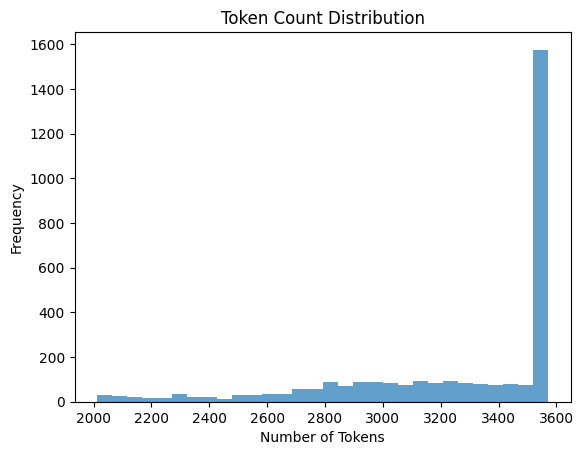

In [29]:
plt.hist(list_num_token, bins=30, alpha=0.7)
plt.title('Token Count Distribution')
plt.xlabel('Number of Tokens')
plt.ylabel('Frequency')
plt.show()

In [30]:
# calculate how many data will be truncated, max_token_input = max_token_output
num_truncate = sum([1 for num_token in list_num_token if num_token > args.max_token_input])
proportion_truncate = num_truncate / len(list_num_token)
print(f"The number of data will be truncated: {num_truncate}")
print(f"The proportion of data will be truncated: {proportion_truncate:.2%}") 

The number of data will be truncated: 0
The proportion of data will be truncated: 0.00%


In [31]:
num_sample = len(list_input)
list_input = list_input[:num_sample]

In [32]:
list_pred = []
output = model.generate(list_input, sampling_params=sampling_params, use_tqdm=True)
for output_one in output:
    generated_text = output_one.outputs[0].text
    list_pred.append(generated_text)

Processed prompts: 100%|██████████| 3183/3183 [09:28<00:00,  5.60it/s, est. speed input: 18262.30 toks/s, output: 40.22 toks/s]


## Result

In [33]:
for input_text, pred_text in zip(list_input, list_pred):
    print(f"Input text:\n\t{input_text}")
    print("-"*50)
    print(f"Generated text:\n\t{pred_text}")
    print("="*100)


Input text:
	Given a patient's basic information and clinical notes in Portuguese, predict whether the patient will require more than seven days of hospitalization.
Return your answer in the following format. DO NOT GIVE ANY EXPLANATION:
Hospitalization > 7 days: label
The optional list for "label" is ["Yes", "No"].

INPUT: Age: 72
Skin Color: Branca
Sex: Male
Exam records:
Time: 2029-10-02 12:04:29. Exam: Basófilos-15.0 /µL
Time: 2029-10-02 13:35:27. Exam: Bilirrubina Total-0.4 mg/dL
Time: 2029-10-02 14:05:52. Exam: Cálcio Iônico-5.33 mg/dL
Time: 2029-10-02 12:04:29. Exam: C.H.C.M.-32.9 g/dL
Time: 2029-10-02 13:35:28. Exam: Creatinina-0.89 mg/dL
Time: 2029-10-02 12:04:29. Exam: Eosinófilos-94.0 /µL
Time: 2029-10-02 12:04:29. Exam: Eritócitos-4.89 milhões/µL
Time: 2029-10-02 12:04:29. Exam: Eritrócitos-4.89 milhões/µL
Time: 2029-10-02 13:35:28. Exam: Ferro-77.0 µg/dL
Time: 2029-10-02 13:37:42. Exam: Fósforo-3.3 mg/dL
Time: 2029-10-02 13:37:42. Exam: Fósforo Inorgânico-3.3 mg/dL
Time: 2

In [40]:
for idx_data, dict_data in enumerate(list_dict_data[:num_sample]):
    dict_data["pred"] = list_pred[idx_data]

In [50]:
list_pred_extracted = task.get_pred(list_dict_data[:num_sample], prompt_mode="direct")
list_label_extracted = task.get_label(list_dict_data[:num_sample], prompt_mode="direct")

In [54]:
list_pred

['0',
 '1',
 '0',
 ' Hospitalization > 7 days: Yes',
 '0',
 '1',
 '\n Hospitalization > 7 days: No',
 ' Hospitalization > 7 days: No',
 '1',
 '0',
 ' Hospitalization > 7 days: No',
 '1',
 ' Hospitalization > 7 days: No',
 '1',
 '1',
 '1',
 '0',
 '1',
 '07',
 ' Hospitalization > 7 days: No',
 ' Hospitalization > 7 days: No',
 '1',
 '1',
 '1',
 ' Hospitalization > 7 days: No',
 '1',
 '1',
 ' Hospitalization > 7 days: No',
 '1',
 '0',
 ' Hospitalization > 7 days: No',
 '1',
 ' Hospitalization > 7 days: No',
 ' Hospitalization > 7 days: No',
 ' Hospitalization > 7 days: Yes',
 ' Hospitalization > 7 days: No',
 '1',
 '1',
 ' Hospitalization > 7 days: No',
 '1',
 ' Hospitalization > 7 days: Yes',
 '0',
 '0',
 '1',
 ' Hospitalization > 7 days: No',
 ' Hospitalization > 7 days: No',
 ' Hospitalization > 7 days: Yes',
 '1',
 ' False',
 '1',
 ' Hospitalization > 7 days: No',
 ' Hospitalization > 7 days: No',
 '0',
 '1',
 '1',
 ' Hospitalization > 7 days: Yes',
 ' Hospitalization > 7 days: No',
 

In [51]:
list_pred_extracted

[-1,
 -1,
 -1,
 1,
 -1,
 -1,
 0,
 0,
 -1,
 -1,
 0,
 -1,
 0,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 0,
 0,
 -1,
 -1,
 -1,
 0,
 -1,
 -1,
 0,
 -1,
 -1,
 0,
 -1,
 0,
 0,
 1,
 0,
 -1,
 -1,
 0,
 -1,
 1,
 -1,
 -1,
 -1,
 0,
 0,
 1,
 -1,
 -1,
 -1,
 0,
 0,
 -1,
 -1,
 -1,
 1,
 0,
 -1,
 -1,
 -1,
 -1,
 -1,
 0,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 0,
 0,
 -1,
 -1,
 0,
 -1,
 0,
 -1,
 0,
 0,
 -1,
 -1,
 1,
 -1,
 -1,
 -1,
 0,
 -1,
 1,
 1,
 1,
 1,
 -1,
 -1,
 -1,
 1,
 0,
 -1,
 0,
 1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 0,
 -1,
 -1,
 -1,
 -1,
 -1,
 0,
 0,
 0,
 -1,
 -1,
 -1,
 -1,
 -1,
 0,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 0,
 1,
 -1,
 1,
 -1,
 0,
 -1,
 0,
 -1,
 -1,
 0,
 0,
 -1,
 0,
 0,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 0,
 0,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 0,
 1,
 -1,
 -1,
 -1,
 0,
 -1,
 -1,
 0,
 0,
 -1,
 0,
 0,
 -1,
 0,
 1,
 0,
 0,
 0,
 1,
 -1,
 1,
 -1,
 0,
 -1,
 0,
 -1,
 1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 0,
 0,
 1,
 -1,
 -1,
 -1,
 -1,
 -1,
 1,
 -1,
 0,
 -1,
 0,
 -1,
 0,
 -1,
 0,
 -1,
 -1,
 1,
 -1,
 0

In [52]:
num_failed = sum([pred == -1 for pred in list_pred_extracted])
num_failed, num_failed / num_sample

(1938, 0.6088595664467483)

In [53]:
task.get_performance(list_pred_extracted, list_label_extracted)

{'accuracy': 26.861451460885956,
 'precision_macro': 56.51672240802675,
 'recall_macro': 22.40665089783058,
 'f1_macro': 31.98521803399852,
 'precision_micro': 68.67469879518072,
 'recall_micro': 26.861451460885956,
 'f1_micro': 38.61788617886179}

## End

In [ ]:
print('Done!')

Done!


In [55]:
from vertexai.preview import tokenization

In [56]:
model_name = "gemini-1.5-pro"
tokenizer = tokenization.get_tokenizer_for_model("gemini-1.5-pro-002")

In [57]:
type(tokenizer)

vertexai.tokenization._tokenizers.PreviewTokenizer

In [59]:
tokenizer.__class__

vertexai.tokenization._tokenizers.PreviewTokenizer

In [61]:
tokenizer.__dict__

{'_sentencepiece_adapter': <vertexai.tokenization._tokenizers._SentencePieceAdaptor at 0x7fa7bd91b7c0>}

In [ ]:
tokenizer.encode("This is a test")

In [ ]:
tokenizer.encode("This is a test", as_dict=True)

In [64]:
from transformers import AutoTokenizer

In [ ]:
tokenizer = AutoTokenizer.from_pretrained("/PHShome/jw1399/clinical_text_dataset/clinical-llm-benchmark/")

In [67]:
with open("tokenizer.model", "rb") as f:
    content = f.read()

In [69]:
content[:100]

b'\n\x0e\n\x05<pad>\x15\x00\x00\x00\x00\x18\x03\n\x0e\n\x05<eos>\x15\x00\x00\x00\x00\x18\x03\n\x0e\n\x05<bos>\x15\x00\x00\x00\x00\x18\x03\n\x0e\n\x05<unk>\x15\x00\x00\x00\x00\x18\x02\n\x0f\n\x06<mask>\x15\x00\x00\x00\x00\x18\x04\n\x10\n\x07<2mass>\x15\x00\x00\x00\x00\x18\x04\n'